<a href="https://colab.research.google.com/github/dude123studios/GANS/blob/main/Cycle_GAN_for_Summer_and_Winter_in_Yosemite.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.losses import mean_squared_error, mean_absolute_error

import os
import time
import matplotlib.pyplot as plt
import numpy as np
import tensorflow_datasets as tfds

In [ ]:
def normalize(input_image, label):  
    input_image = tf.cast(input_image, tf.float32)
    input_image = (input_image / 127.5) - 1
    return input_image

In [ ]:
dataset, metadata = tfds.load('cycle_gan/summer2winter_yosemite', with_info=True, as_supervised=True)

Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteALS3OK/cycle_gan-trainA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteALS3OK/cycle_gan-trainB.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteALS3OK/cycle_gan-testA.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0.incompleteALS3OK/cycle_gan-testB.tfrecord


Dataset cycle_gan downloaded and prepared to /root/tensorflow_datasets/cycle_gan/summer2winter_yosemite/2.0.0. Subsequent calls will reuse this data.


In [ ]:
train_A, train_B = dataset['trainA'], dataset['trainB'] 
test_A, test_B = dataset['testA'], dataset['testB']

In [ ]:
BUFFER_SIZE = 1000
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256
EPOCHS = 50
AUTOTUNE = tf.data.experimental.AUTOTUNE

In [ ]:
train_A = train_A.map(normalize, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
train_B = train_B.map(normalize, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
test_A = test_A.map(normalize, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
test_B = test_B.map(normalize, num_parallel_calls=AUTOTUNE).cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

In [ ]:
inpA = next(iter(train_A))
inpB = next(iter(train_B))

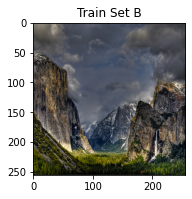

In [ ]:
plt.title("Train Set A")
plt.imshow(inpA[0]*0.5 + 0.5)
plt.subplot(122)
plt.title("Train Set B")
plt.imshow(inpB[0]*0.5 + 0.5)

In [ ]:
def downsample(filters, size=3, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.LeakyReLU())

    return result

In [ ]:
def upsample(filters, size=3, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())

    return result

In [ ]:
class ResnetIdentityBlock(tf.keras.Model):
  def __init__(self, kernel_size, filters):
    super(ResnetIdentityBlock, self).__init__(name='')
    filters1, filters2, filters3 = filters

    self.conv2a = tf.keras.layers.Conv2D(filters1, (1, 1))
    self.bn2a = tf.keras.layers.BatchNormalization()

    self.conv2b = tf.keras.layers.Conv2D(filters2, kernel_size, padding='same')
    self.bn2b = tf.keras.layers.BatchNormalization()

    self.conv2c = tf.keras.layers.Conv2D(filters3, (1, 1))
    self.bn2c = tf.keras.layers.BatchNormalization()

  def call(self, input_tensor, training=False):
    x = self.conv2a(input_tensor)
    x = self.bn2a(x, training=training)
    x = tf.nn.relu(x)

    x = self.conv2b(x)
    x = self.bn2b(x, training=training)
    x = tf.nn.relu(x)

    x = self.conv2c(x)
    x = self.bn2c(x, training=training)

    x += input_tensor
    return tf.nn.relu(x)

    
block1 = ResnetIdentityBlock(3, [512, 512, 512])
block2 = ResnetIdentityBlock(3, [512, 512, 512])
block3 = ResnetIdentityBlock(3, [512, 512, 512])


resnet = [block1, block2, block3]
print(block1(tf.zeros([1, 16, 16, 512])).shape)
print([x.name for x in block1.trainable_variables])

(1, 16, 16, 512)
['resnet_identity_block/conv2d/kernel:0', 'resnet_identity_block/conv2d/bias:0', 'resnet_identity_block/batch_normalization/gamma:0', 'resnet_identity_block/batch_normalization/beta:0', 'resnet_identity_block/conv2d_1/kernel:0', 'resnet_identity_block/conv2d_1/bias:0', 'resnet_identity_block/batch_normalization_1/gamma:0', 'resnet_identity_block/batch_normalization_1/beta:0', 'resnet_identity_block/conv2d_2/kernel:0', 'resnet_identity_block/conv2d_2/bias:0', 'resnet_identity_block/batch_normalization_2/gamma:0', 'resnet_identity_block/batch_normalization_2/beta:0']


In [ ]:

def Generator():
    down_stack = [
        downsample(64, 4, apply_batchnorm=False), 
        downsample(128, 4),
        downsample(256, 4), 
        downsample(512, 4) 
    ]

    up_stack = [
        upsample(256, 4),
        upsample(128, 4), 
        upsample(64, 4), 
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(3, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') 


    inputs = tf.keras.layers.Input(shape=[256, 256, 3])
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
        
    for block in resnet:
        x = block(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        concat = tf.keras.layers.Concatenate()
        x = up(x)
        x = concat([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
def Discriminator():
    inputs = tf.keras.layers.Input(shape=[None,None,3])
    x = inputs
    g_filter = 64
    
    down_stack = [
        downsample(g_filter),
        downsample(g_filter * 2),
        downsample(g_filter * 4),
        downsample(g_filter * 8),
    ]
    
    for down in down_stack:
        x = down(x)

    last = tf.keras.layers.Conv2D(1, 4, strides=1, padding='same') # (bs, 30, 30, 1)
    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
discriminator_A = Discriminator()
discriminator_B = Discriminator()

generator_AB = Generator()
generator_BA = Generator()

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
@tf.function
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

In [ ]:
optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

In [ ]:
valid = np.ones((BATCH_SIZE, 16, 16, 1)).astype('float32')
fake = np.zeros((BATCH_SIZE, 16, 16, 1)).astype('float32')

In [ ]:
@tf.function
def train_batch(imgs_A, imgs_B):
    with tf.GradientTape() as g, tf.GradientTape() as d_tape:
        fake_B = generator_AB(imgs_A, training=True)
        fake_A = generator_BA(imgs_B, training=True)
        
        logits_real_A = discriminator_A(imgs_A, training=True)
        logits_fake_A = discriminator_A(fake_A, training=True)
        dA_loss = discriminator_loss(logits_real_A, logits_fake_A)
        
        logits_real_B = discriminator_B(imgs_B, training=True)
        logits_fake_B = discriminator_B(fake_B, training=True)
        dB_loss = discriminator_loss(logits_real_B, logits_fake_B)
        
        d_loss = (dA_loss + dB_loss) / 2
        # Translate images back to original domain
        reconstr_A = generator_BA(fake_B, training=True)
        reconstr_B = generator_AB(fake_A, training=True)
        
        id_A = generator_BA(imgs_A, training=True)
        id_B = generator_AB(imgs_B, training=True)


        gen_loss = tf.math.reduce_sum([
            1 * tf.math.reduce_mean(mean_squared_error(logits_fake_A, valid)),
            1 * tf.math.reduce_mean(mean_squared_error(logits_fake_B, valid)),
            10 * tf.math.reduce_mean(mean_squared_error(reconstr_A, imgs_A)),
            10 * tf.math.reduce_mean(mean_squared_error(reconstr_B, imgs_B)),
            0.1 * tf.math.reduce_mean(mean_squared_error(id_A, imgs_A)),
            0.1 * tf.math.reduce_mean(mean_squared_error(id_B, imgs_B)),
        ])
        
    gradients_of_d = d_tape.gradient(d_loss, discriminator_A.trainable_variables + discriminator_B.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_d, discriminator_A.trainable_variables + discriminator_B.trainable_variables))

    gradients_of_generator = g.gradient(gen_loss, generator_AB.trainable_variables + generator_BA.trainable_variables)
    optimizer.apply_gradients(zip(gradients_of_generator, generator_AB.trainable_variables + generator_BA.trainable_variables))
    
    return dA_loss, dB_loss, gen_loss 

In [ ]:
checkpoint_dird_A = './training_checkpointsd_A'
checkpoint_prefixd_A = os.path.join(checkpoint_dird_A, "ckpt_{epoch}")

checkpoint_dird_B = './training_checkpointsd_B'
checkpoint_prefixd_B = os.path.join(checkpoint_dird_B, "ckpt_{epoch}")

checkpoint_dirg_AB = './training_checkpointsg_AB'
checkpoint_prefixg_AB = os.path.join(checkpoint_dirg_AB, "ckpt_{epoch}")

checkpoint_dirg_BA = './training_checkpointsg_BA'
checkpoint_prefixg_BA = os.path.join(checkpoint_dirg_BA, "ckpt_{epoch}")

In [ ]:
def train(trainA_, trainB_, epochs):
    for epoch in range(epochs):
        start = time.time()
        
        for batch_i, (imgs_A, imgs_B) in enumerate(zip(trainA_, trainB_)):
            dA_loss, dB_loss, g_loss = train_batch(imgs_A, imgs_B)
            
            if batch_i % 1000 == 0:
                test_imgA = next(iter(test_A))
                test_imgB = next(iter(test_B))
                print ('Time taken for epoch {} batch index {} is {} seconds\n'.format(epoch, batch_i, time.time()-start))
                print("discriminator A: ", dA_loss.numpy())
                print("discriminator B: ", dB_loss.numpy())
                print("generator: {}\n".format(g_loss))

                fig, axs = plt.subplots(2, 2, figsize=(10, 10), sharey=True, sharex=True)
                gen_outputA = generator_AB(test_imgA, training=False)
                gen_outputB = generator_BA(test_imgB, training=False)
                axs[0,0].imshow(test_imgA[0]*0.5 + 0.5)
                axs[0,0].set_title("Generator A Input")
                axs[0,1].imshow(gen_outputA[0]*0.5 + 0.5)
                axs[0,1].set_title("Generator A Output")
                axs[1,0].imshow(test_imgB[0]*0.5 + 0.5)
                axs[1,0].set_title("Generator B Input")
                axs[1,1].imshow(gen_outputB[0]*0.5 + 0.5)
                axs[1,1].set_title("Generator B Output")
                plt.show()

                discriminator_A.save_weights(checkpoint_prefixd_A.format(epoch=epoch))
                discriminator_B.save_weights(checkpoint_prefixd_B.format(epoch=epoch))
                generator_AB.save_weights(checkpoint_prefixg_AB.format(epoch=epoch))
                generator_BA.save_weights(checkpoint_prefixg_BA.format(epoch=epoch))

Time taken for epoch 0 batch index 0 is 9.840887308120728 seconds

discriminator A:  1.5830555
discriminator B:  1.5972208
generator: 9.068134307861328



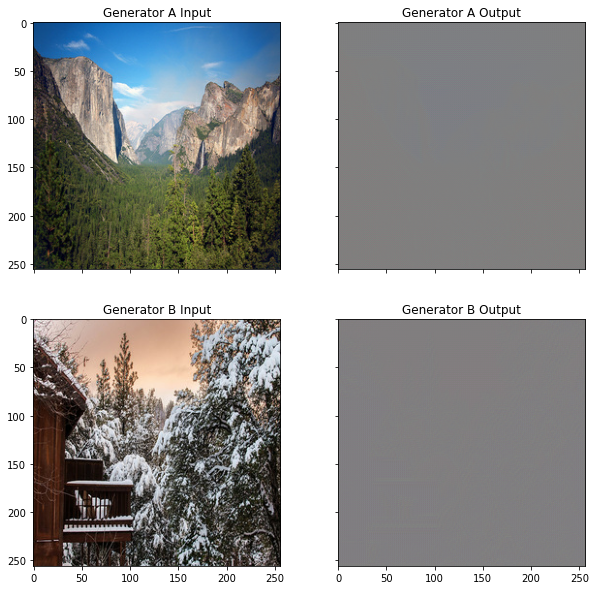

Time taken for epoch 1 batch index 0 is 0.18490362167358398 seconds

discriminator A:  1.3594351
discriminator B:  1.3981851
generator: 3.109297275543213



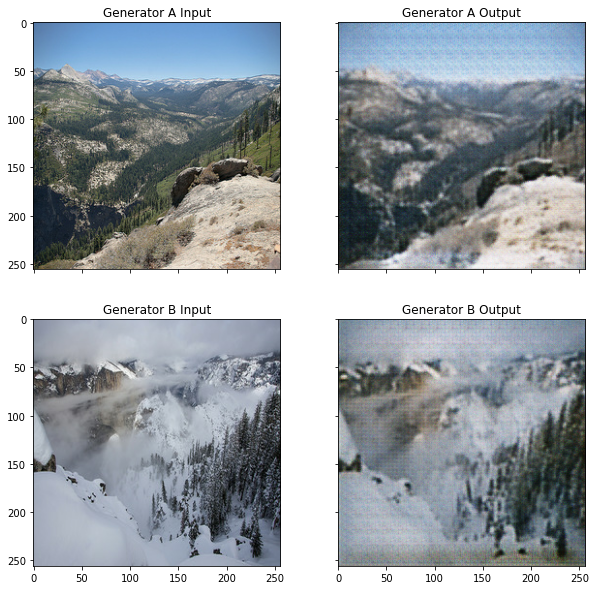

Time taken for epoch 2 batch index 0 is 0.18410611152648926 seconds

discriminator A:  1.4442155
discriminator B:  1.4530528
generator: 2.6152639389038086



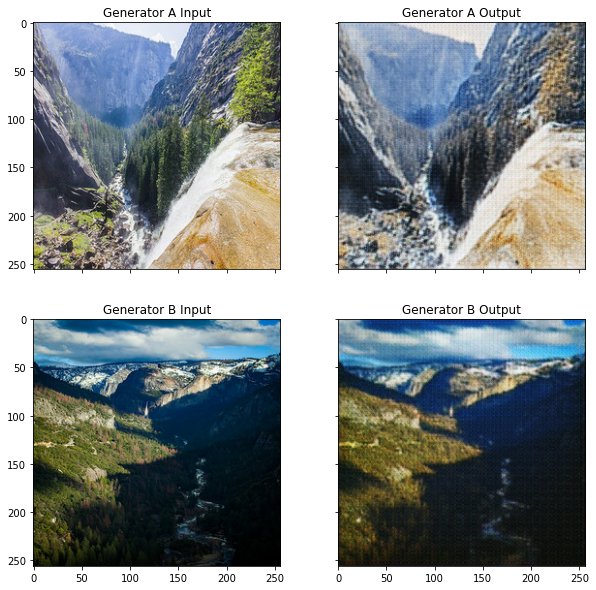

Time taken for epoch 3 batch index 0 is 0.18422150611877441 seconds

discriminator A:  1.3850422
discriminator B:  1.3885876
generator: 2.627591133117676



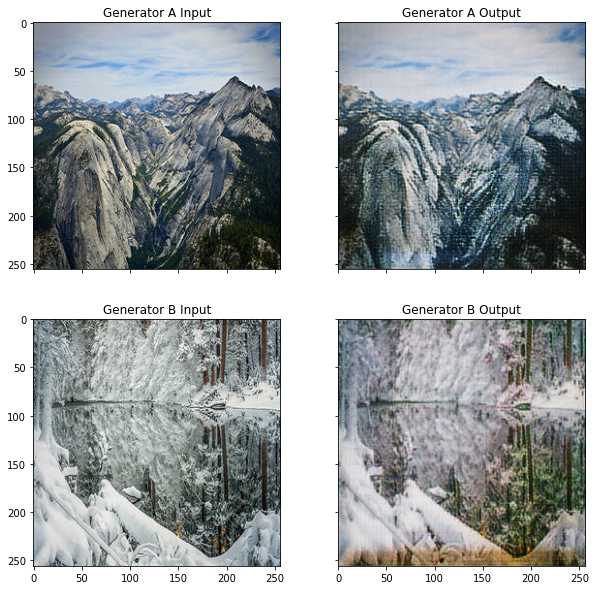

Time taken for epoch 4 batch index 0 is 0.19031023979187012 seconds

discriminator A:  1.3786829
discriminator B:  1.3627245
generator: 2.381432056427002



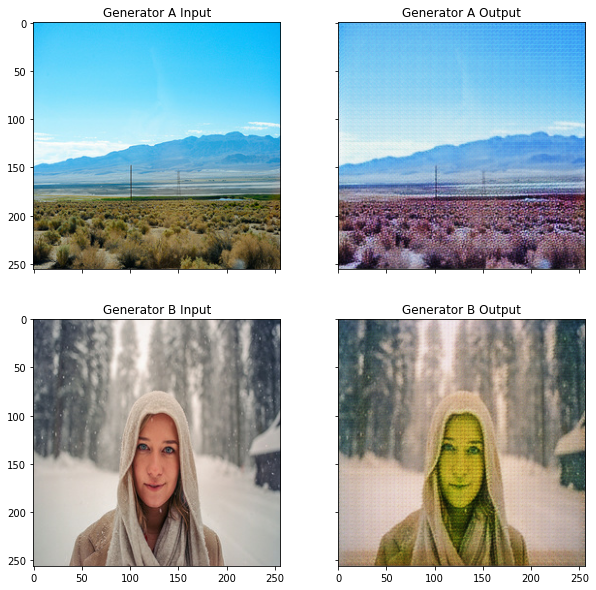

Time taken for epoch 5 batch index 0 is 0.1840193271636963 seconds

discriminator A:  1.410527
discriminator B:  1.3907295
generator: 2.3972020149230957



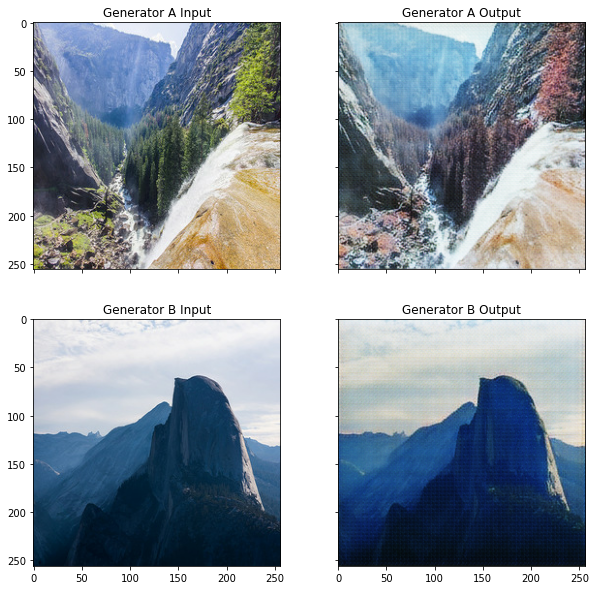

Time taken for epoch 6 batch index 0 is 0.17998886108398438 seconds

discriminator A:  1.3845903
discriminator B:  1.3792505
generator: 2.2089145183563232



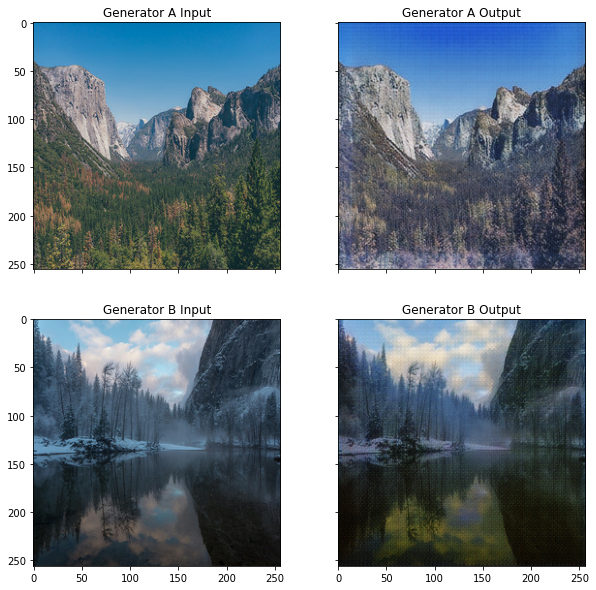

Time taken for epoch 7 batch index 0 is 0.18841862678527832 seconds

discriminator A:  1.4110416
discriminator B:  1.3979166
generator: 2.1335957050323486



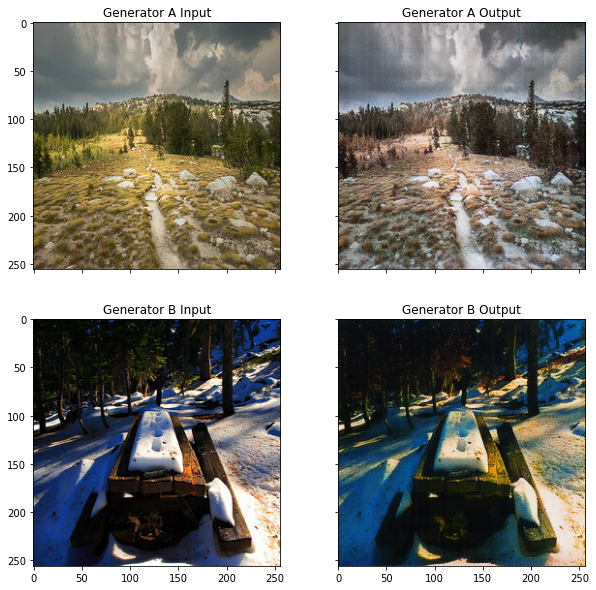

Time taken for epoch 8 batch index 0 is 0.18870759010314941 seconds

discriminator A:  1.4002161
discriminator B:  1.3817482
generator: 2.7493834495544434



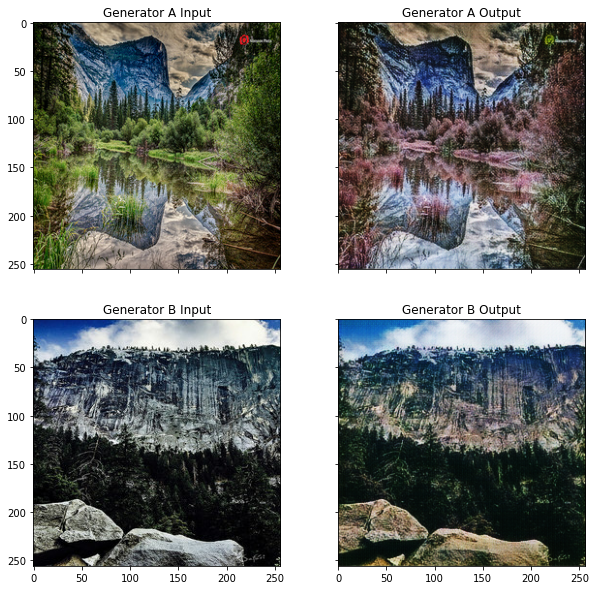

Time taken for epoch 9 batch index 0 is 0.18758201599121094 seconds

discriminator A:  1.3765552
discriminator B:  1.3706261
generator: 2.305065155029297



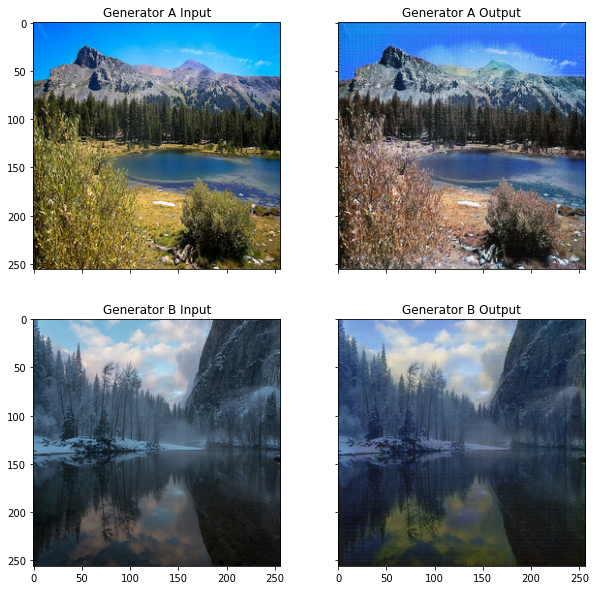

Time taken for epoch 10 batch index 0 is 0.18648552894592285 seconds

discriminator A:  1.4180558
discriminator B:  1.3892505
generator: 2.1555392742156982



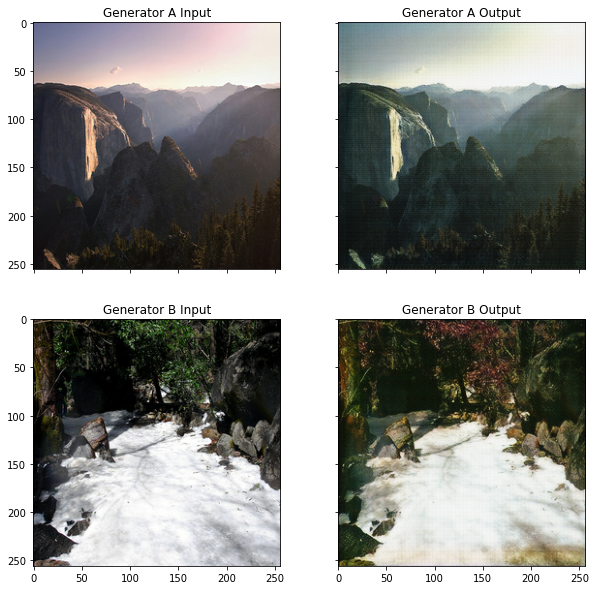

Time taken for epoch 11 batch index 0 is 0.18700313568115234 seconds

discriminator A:  1.370347
discriminator B:  1.3815955
generator: 2.350799798965454



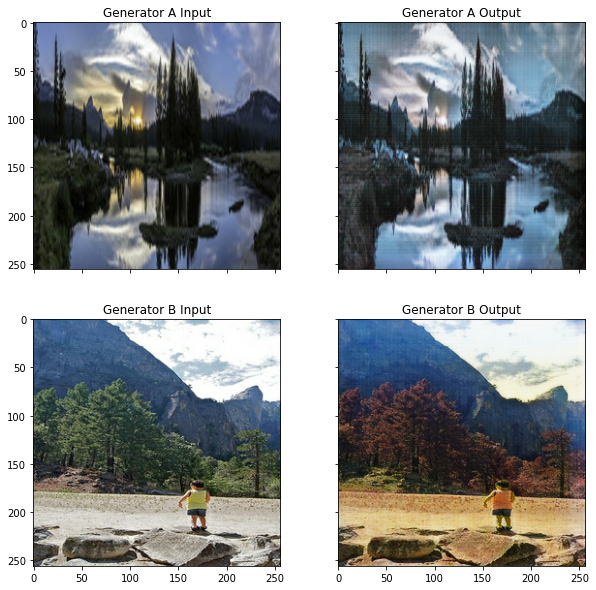

Time taken for epoch 12 batch index 0 is 0.1816420555114746 seconds

discriminator A:  1.4002335
discriminator B:  1.4130316
generator: 2.3009073734283447



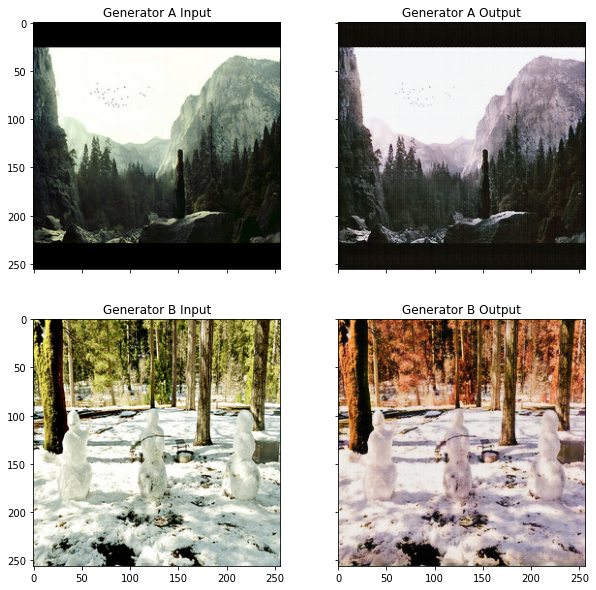

Time taken for epoch 13 batch index 0 is 0.18248438835144043 seconds

discriminator A:  1.3936014
discriminator B:  1.3882371
generator: 2.2190723419189453



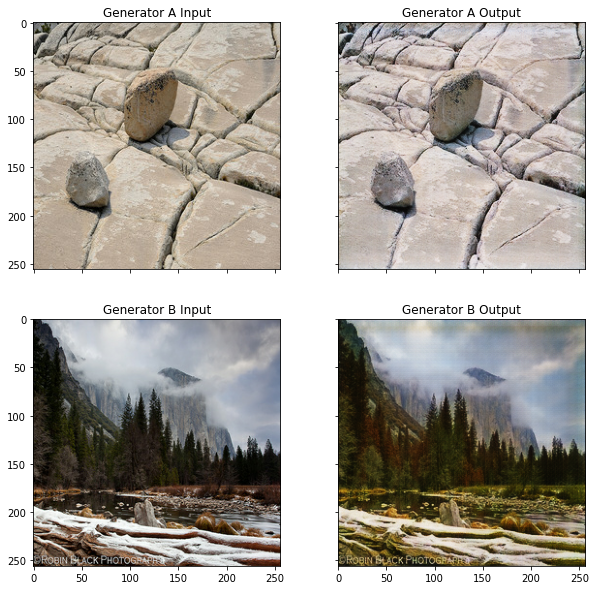

Time taken for epoch 14 batch index 0 is 0.1878962516784668 seconds

discriminator A:  1.3718636
discriminator B:  1.3770318
generator: 2.16983699798584



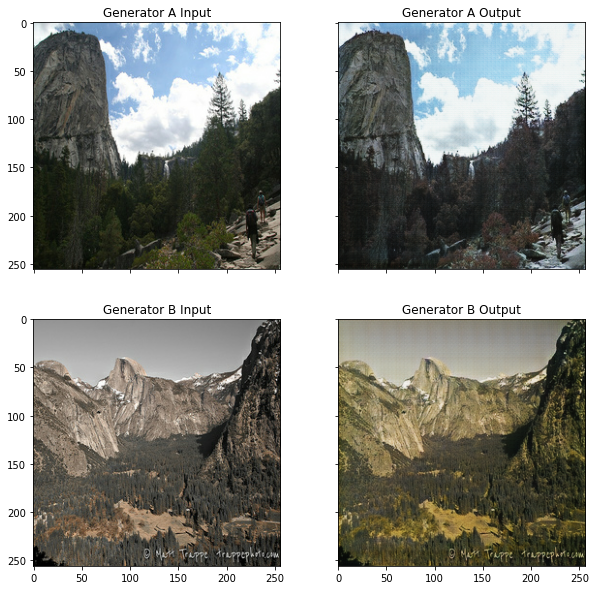

Time taken for epoch 15 batch index 0 is 0.18897652626037598 seconds

discriminator A:  1.3947611
discriminator B:  1.4042559
generator: 2.2351036071777344



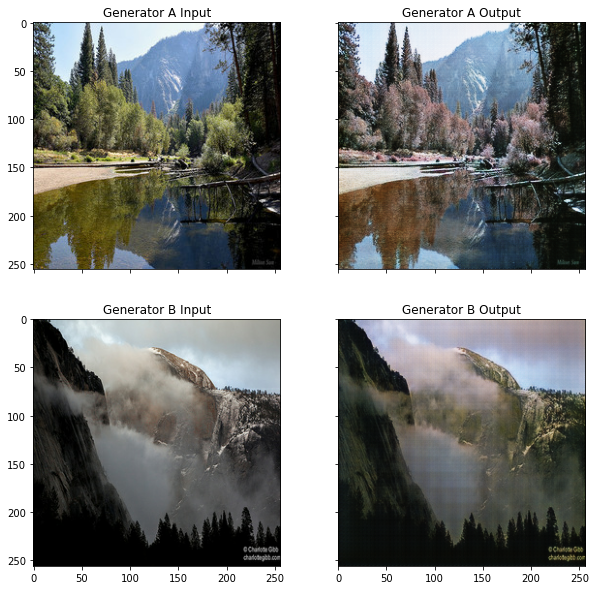

Time taken for epoch 16 batch index 0 is 0.1889050006866455 seconds

discriminator A:  1.3913426
discriminator B:  1.3959987
generator: 2.0812158584594727



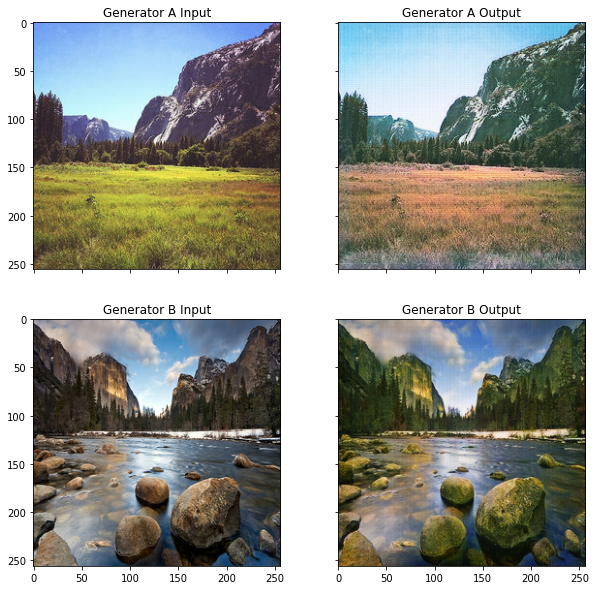

Time taken for epoch 17 batch index 0 is 0.19055557250976562 seconds

discriminator A:  1.3721855
discriminator B:  1.3729916
generator: 2.200892210006714



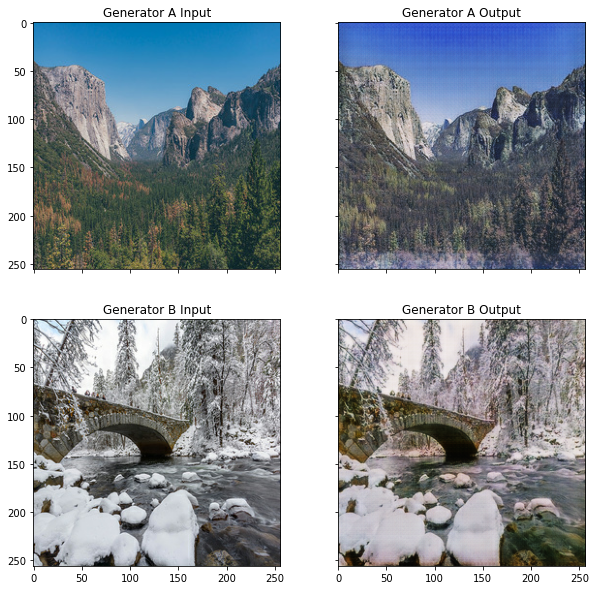

Time taken for epoch 18 batch index 0 is 0.18462681770324707 seconds

discriminator A:  1.4313207
discriminator B:  1.4621392
generator: 1.8698885440826416



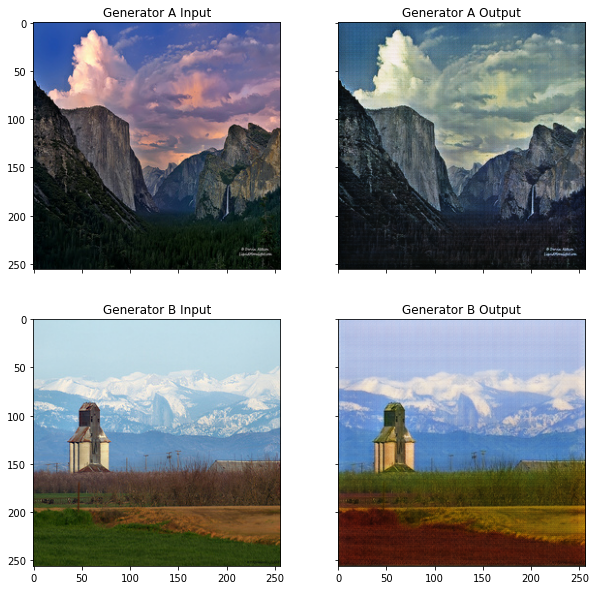

Time taken for epoch 19 batch index 0 is 0.18818044662475586 seconds

discriminator A:  1.3876643
discriminator B:  1.415278
generator: 2.2316155433654785



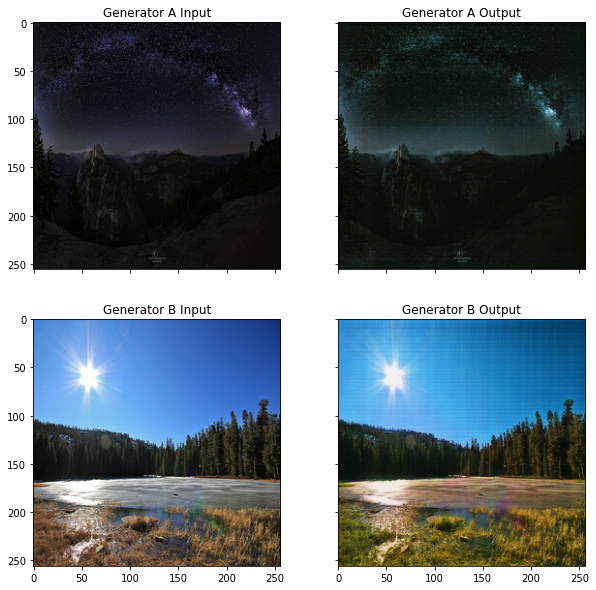

Time taken for epoch 20 batch index 0 is 0.186143159866333 seconds

discriminator A:  1.395688
discriminator B:  1.405977
generator: 2.1930718421936035



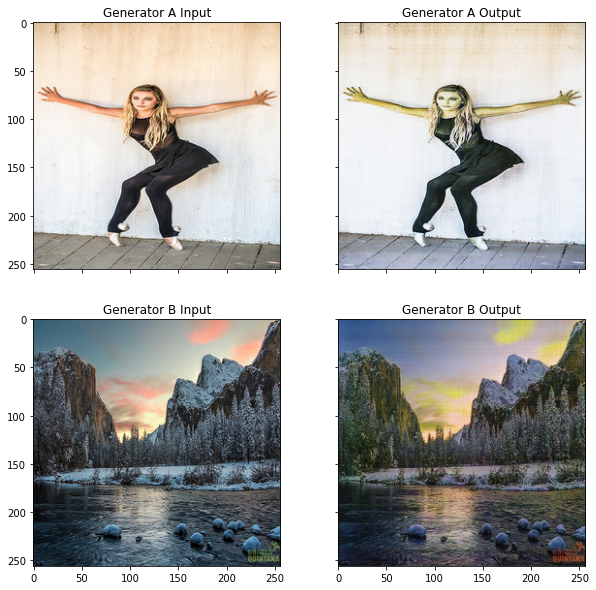

Time taken for epoch 21 batch index 0 is 0.18866252899169922 seconds

discriminator A:  1.3955309
discriminator B:  1.3975327
generator: 2.072094678878784



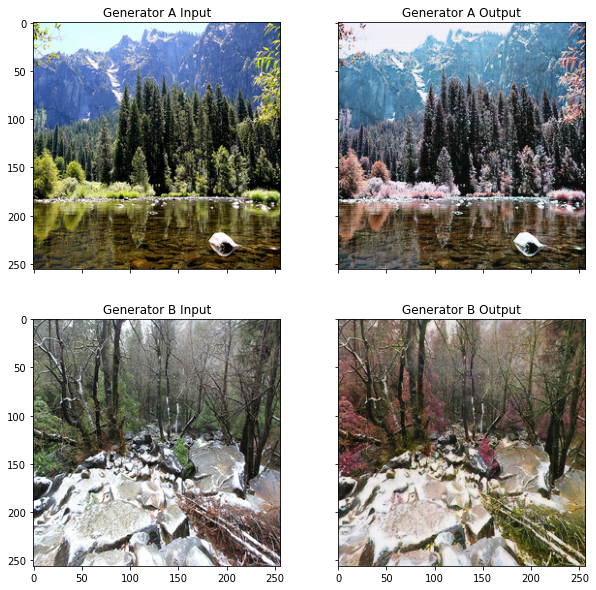

Time taken for epoch 22 batch index 0 is 0.18973708152770996 seconds

discriminator A:  1.4029061
discriminator B:  1.3905401
generator: 2.0645761489868164



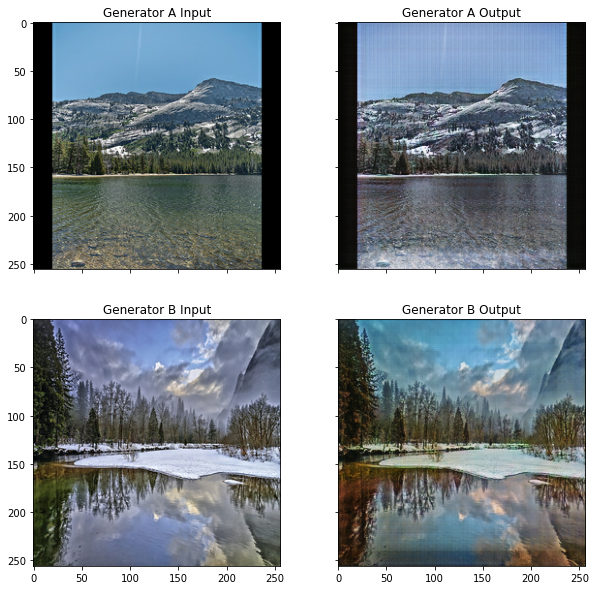

Time taken for epoch 23 batch index 0 is 0.18879246711730957 seconds

discriminator A:  1.3752708
discriminator B:  1.3755374
generator: 2.0552821159362793



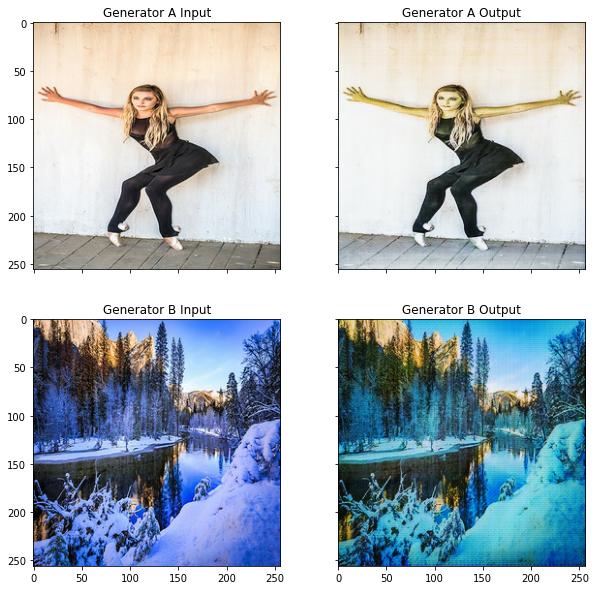

Time taken for epoch 24 batch index 0 is 0.18943405151367188 seconds

discriminator A:  1.4105353
discriminator B:  1.3948364
generator: 2.235621452331543



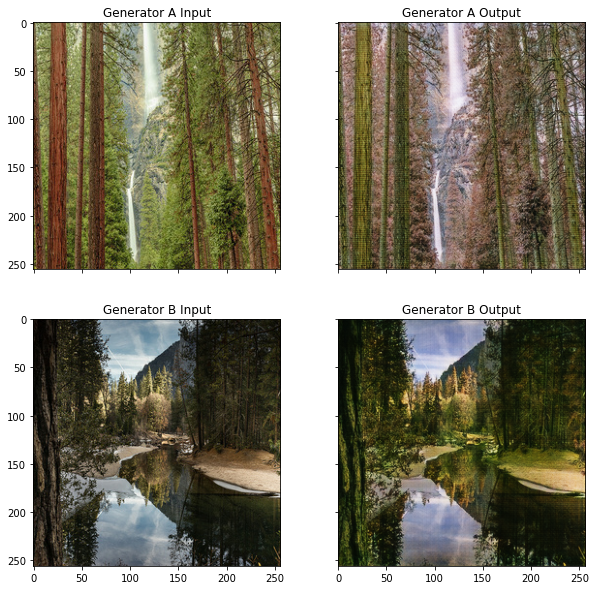

Time taken for epoch 25 batch index 0 is 0.18553709983825684 seconds

discriminator A:  1.3821838
discriminator B:  1.390208
generator: 2.059347152709961



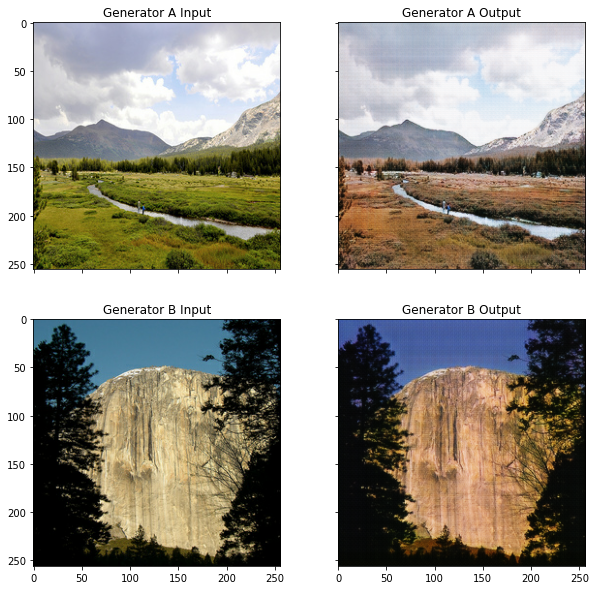

Time taken for epoch 26 batch index 0 is 0.1844780445098877 seconds

discriminator A:  1.3910127
discriminator B:  1.3898716
generator: 1.893019676208496



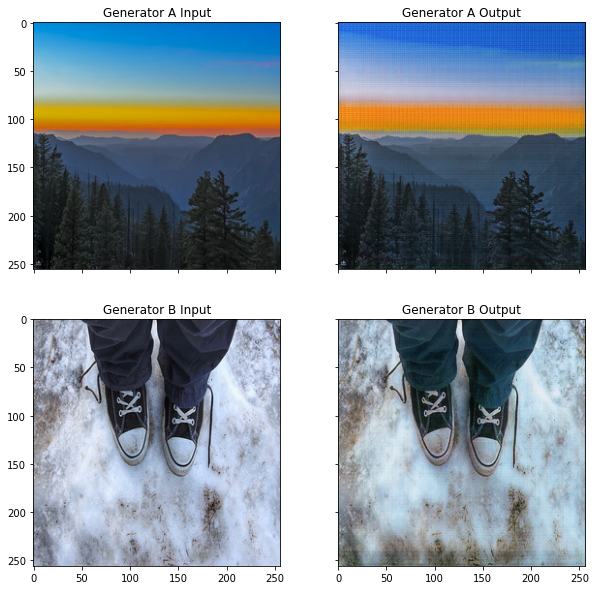

Time taken for epoch 27 batch index 0 is 0.18600678443908691 seconds

discriminator A:  1.3792787
discriminator B:  1.3841712
generator: 2.0318946838378906



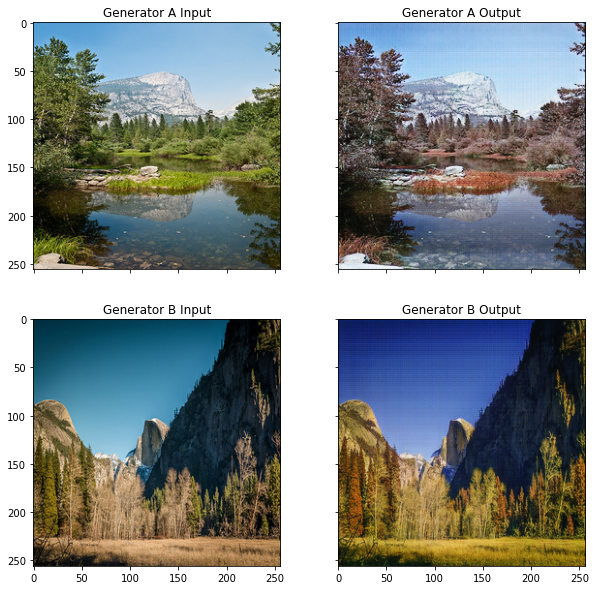

Time taken for epoch 28 batch index 0 is 0.18864965438842773 seconds

discriminator A:  1.3896075
discriminator B:  1.3986819
generator: 2.3310086727142334



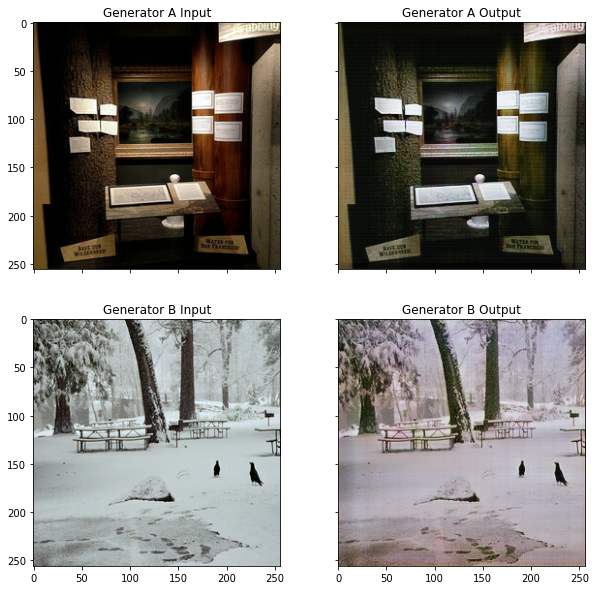

Time taken for epoch 29 batch index 0 is 0.1838359832763672 seconds

discriminator A:  1.3876612
discriminator B:  1.3797363
generator: 2.1917481422424316



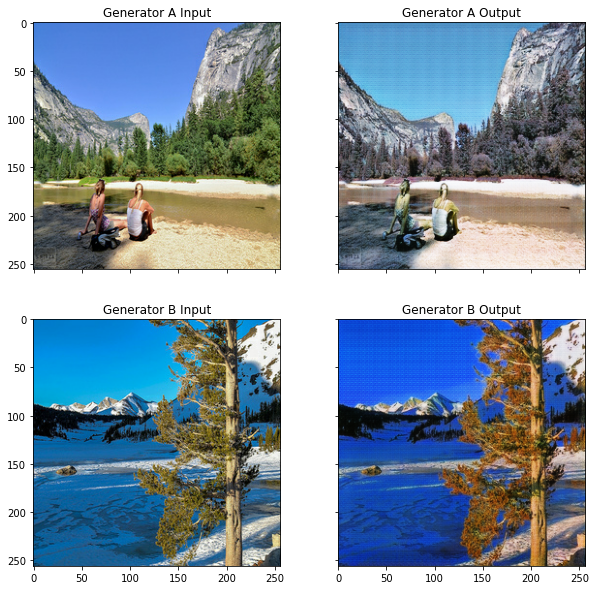

Time taken for epoch 30 batch index 0 is 0.18433928489685059 seconds

discriminator A:  1.3975401
discriminator B:  1.3894482
generator: 1.9441978931427002



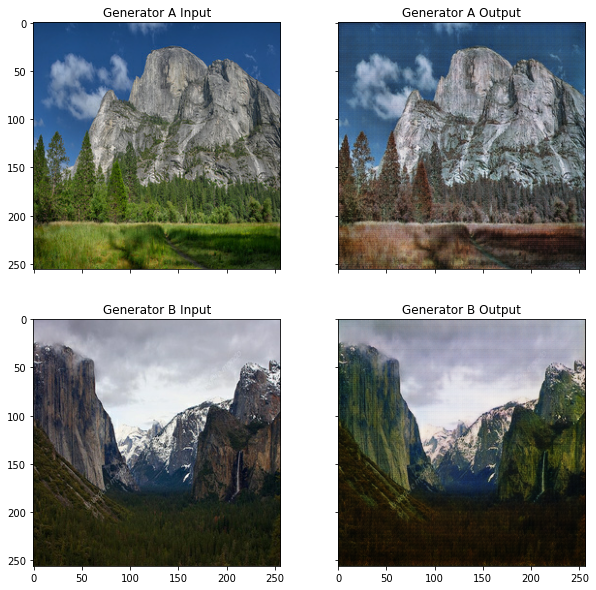

Time taken for epoch 31 batch index 0 is 0.1870572566986084 seconds

discriminator A:  1.3990306
discriminator B:  1.4118056
generator: 2.177164316177368



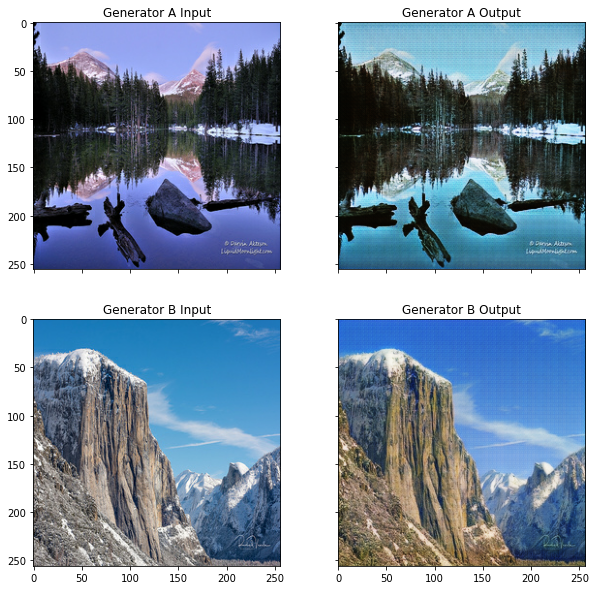

Time taken for epoch 32 batch index 0 is 0.18950700759887695 seconds

discriminator A:  1.3801144
discriminator B:  1.3838952
generator: 2.512590169906616



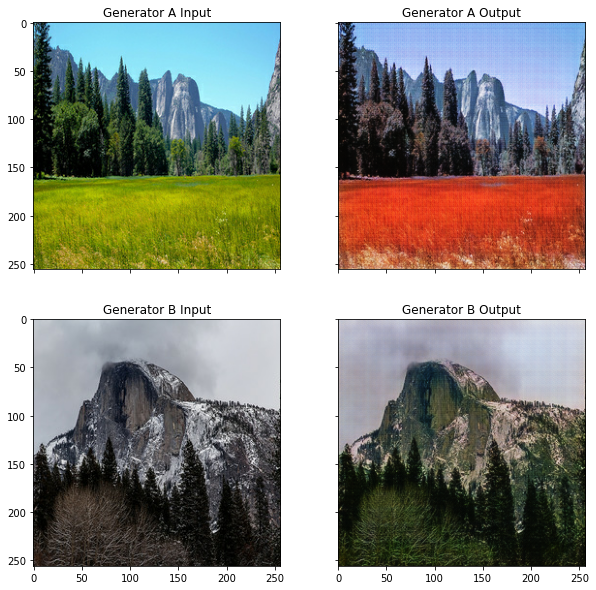

Time taken for epoch 33 batch index 0 is 0.18393802642822266 seconds

discriminator A:  1.3921878
discriminator B:  1.4051172
generator: 2.307438373565674



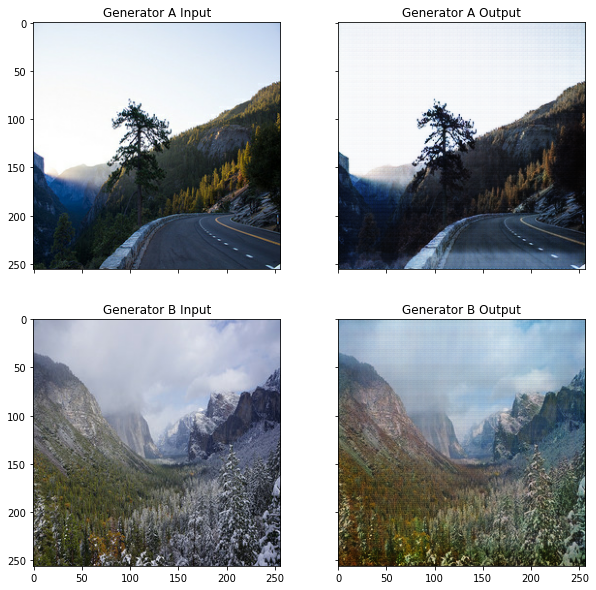

Time taken for epoch 34 batch index 0 is 0.18576931953430176 seconds

discriminator A:  1.3909078
discriminator B:  1.389365
generator: 2.12793231010437



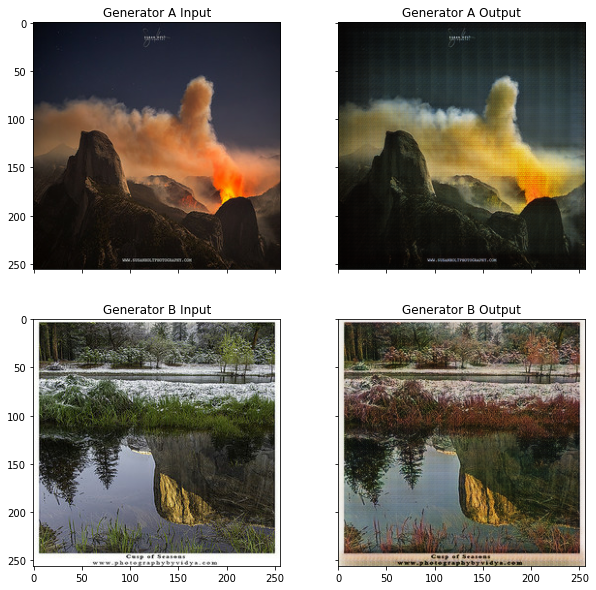

Time taken for epoch 35 batch index 0 is 0.186812162399292 seconds

discriminator A:  1.4073673
discriminator B:  1.3884121
generator: 1.9637354612350464



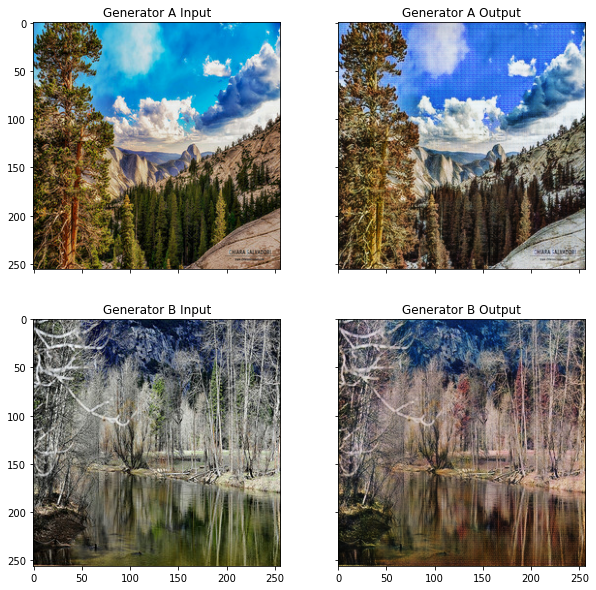

Time taken for epoch 36 batch index 0 is 0.18859529495239258 seconds

discriminator A:  1.3877627
discriminator B:  1.3923696
generator: 2.227346897125244



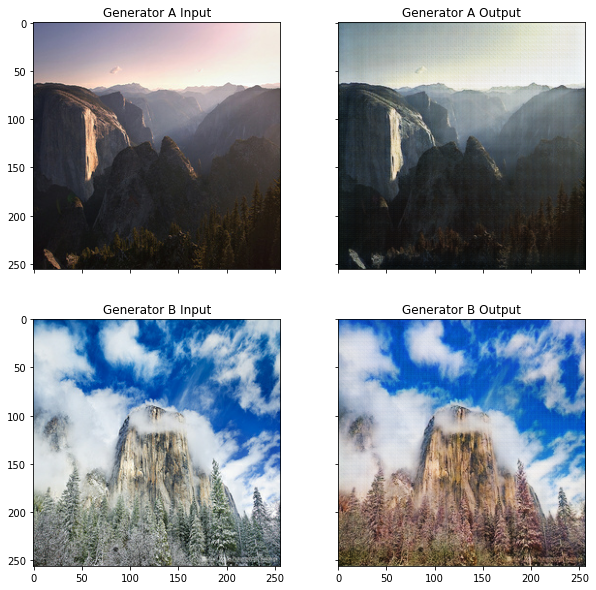

Time taken for epoch 37 batch index 0 is 0.19327998161315918 seconds

discriminator A:  1.3933192
discriminator B:  1.3605402
generator: 2.6260504722595215



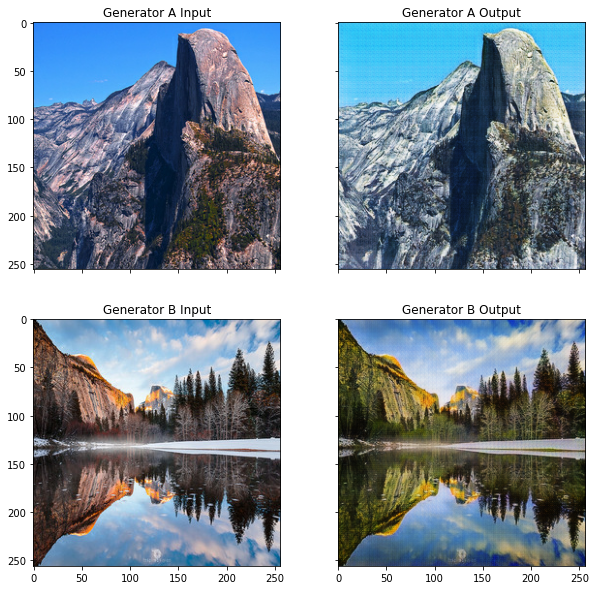

Time taken for epoch 38 batch index 0 is 0.1893763542175293 seconds

discriminator A:  1.3831878
discriminator B:  1.4013026
generator: 2.392444372177124



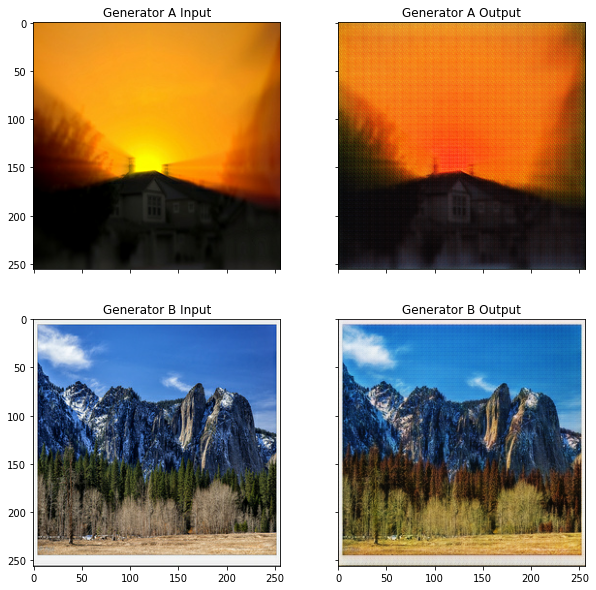

Time taken for epoch 39 batch index 0 is 0.1787731647491455 seconds

discriminator A:  1.4067432
discriminator B:  1.3779614
generator: 1.721770167350769



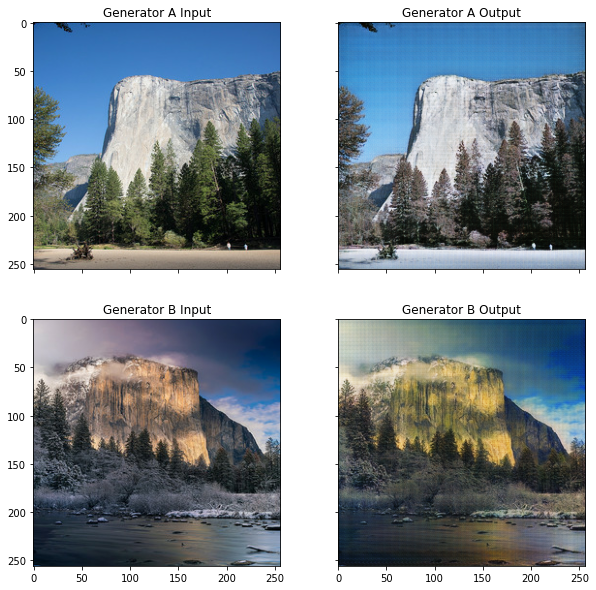

Time taken for epoch 40 batch index 0 is 0.1878499984741211 seconds

discriminator A:  1.3914781
discriminator B:  1.3906648
generator: 2.183907985687256



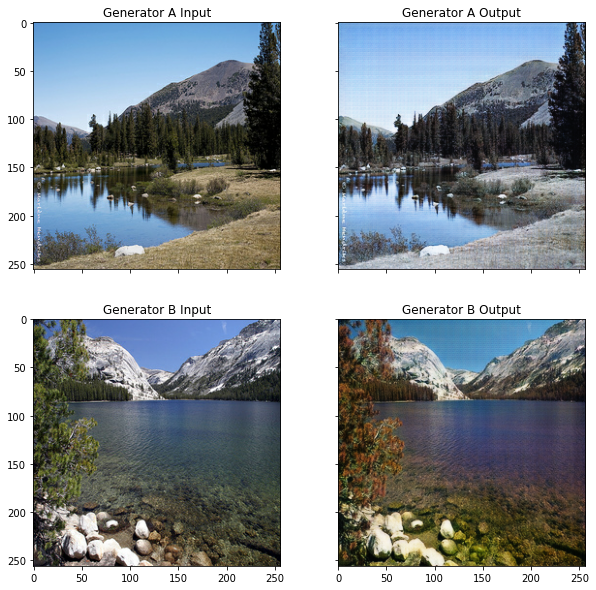

Time taken for epoch 41 batch index 0 is 0.18982625007629395 seconds

discriminator A:  1.422425
discriminator B:  1.4021049
generator: 2.115968704223633



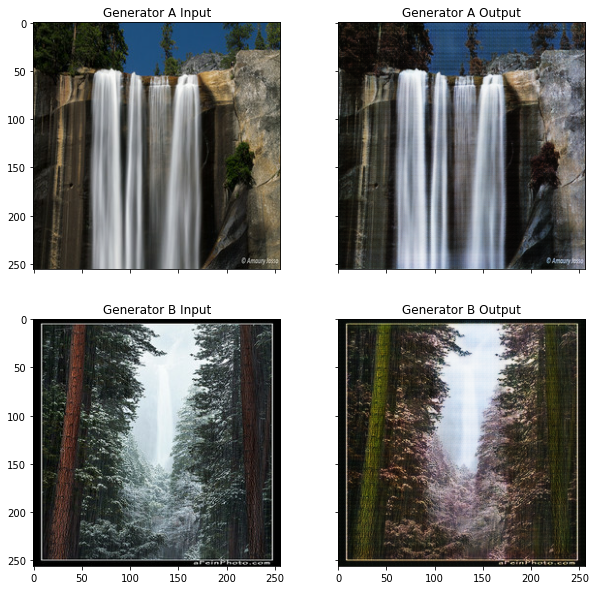

Time taken for epoch 42 batch index 0 is 0.1849198341369629 seconds

discriminator A:  1.3870986
discriminator B:  1.3861616
generator: 2.1933414936065674



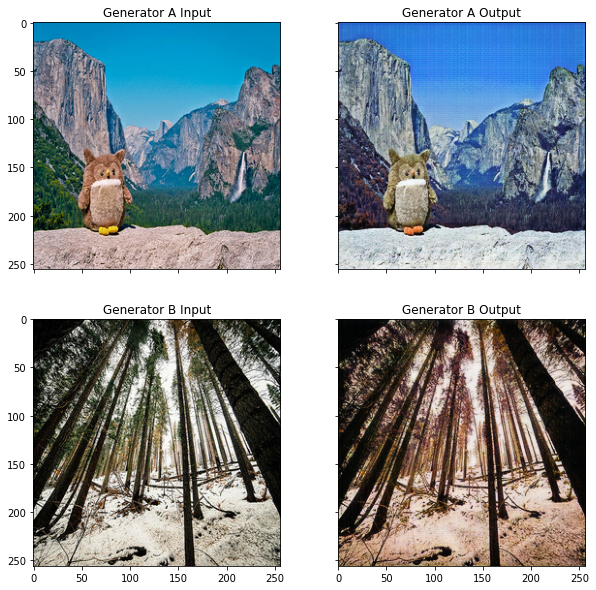

Time taken for epoch 43 batch index 0 is 0.18462848663330078 seconds

discriminator A:  1.3814781
discriminator B:  1.3681136
generator: 2.2530436515808105



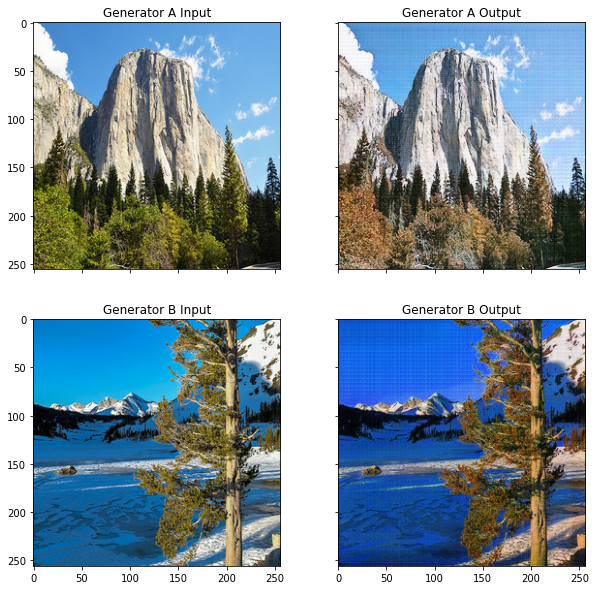

Time taken for epoch 44 batch index 0 is 0.1891179084777832 seconds

discriminator A:  1.4049146
discriminator B:  1.3963748
generator: 2.2305235862731934



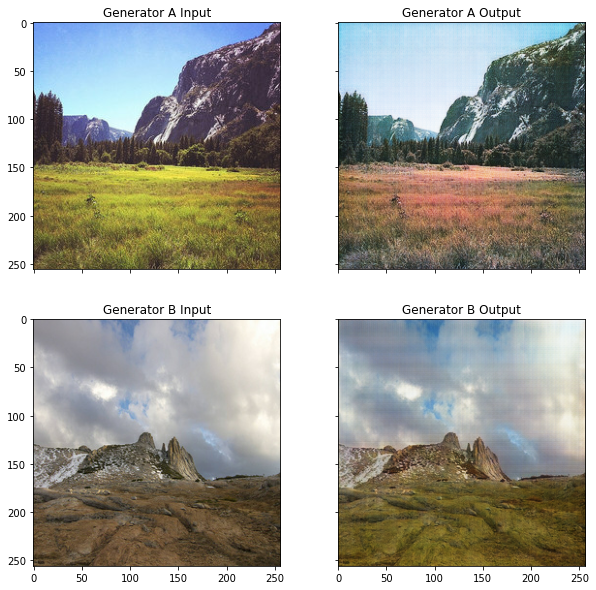

Time taken for epoch 45 batch index 0 is 0.1891617774963379 seconds

discriminator A:  1.396132
discriminator B:  1.403412
generator: 1.9670436382293701



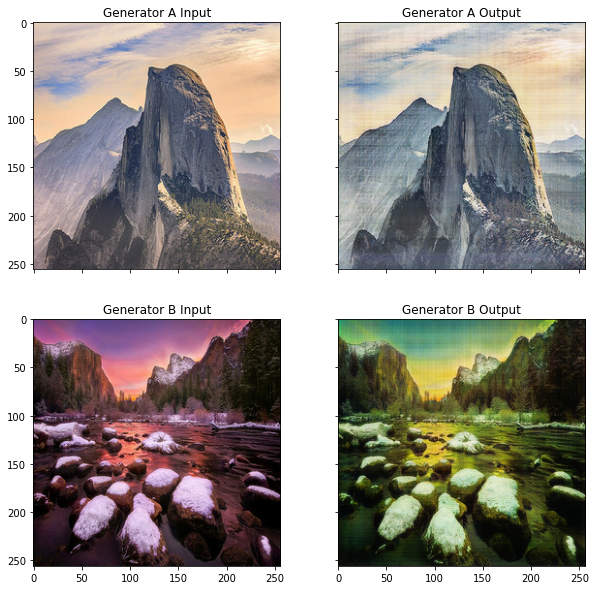

Time taken for epoch 46 batch index 0 is 0.18369197845458984 seconds

discriminator A:  1.3917122
discriminator B:  1.3819804
generator: 2.0575156211853027



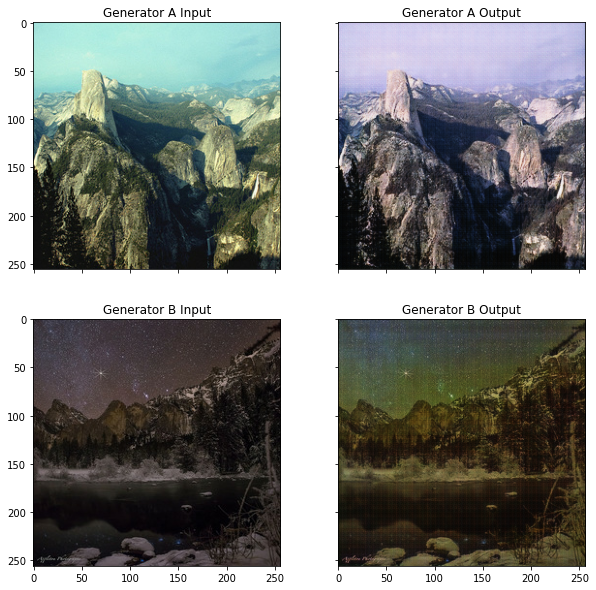

Time taken for epoch 47 batch index 0 is 0.18750500679016113 seconds

discriminator A:  1.3843045
discriminator B:  1.3819814
generator: 2.0454697608947754



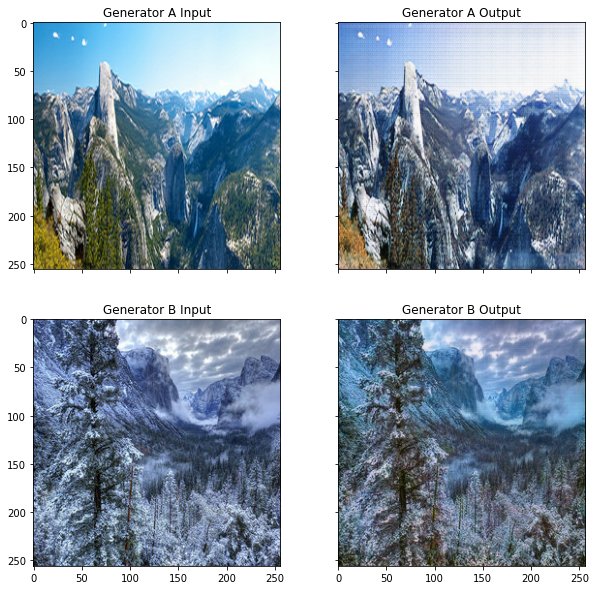

Time taken for epoch 48 batch index 0 is 0.1880800724029541 seconds

discriminator A:  1.3753972
discriminator B:  1.3819159
generator: 2.008121967315674



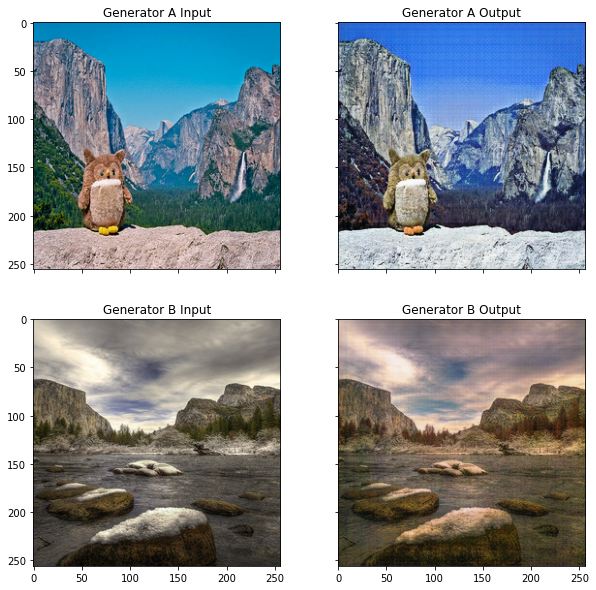

Time taken for epoch 49 batch index 0 is 0.1810007095336914 seconds

discriminator A:  1.3931098
discriminator B:  1.3904665
generator: 2.145036220550537



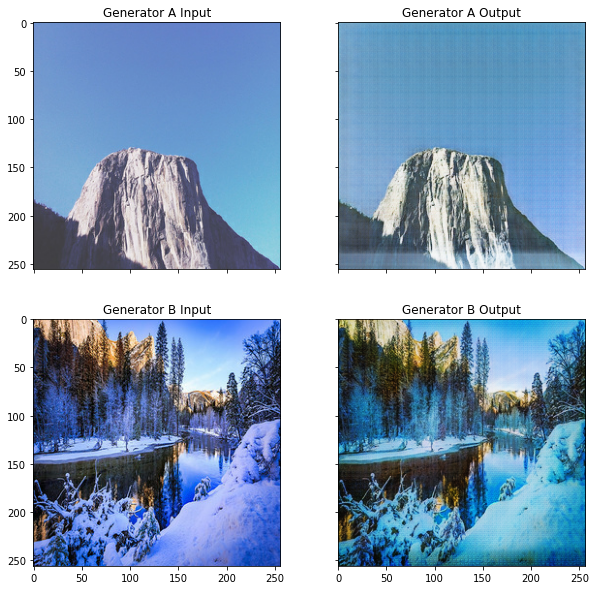

In [ ]:
with tf.device('gpu:0'):
  train(train_A, train_B, EPOCHS)